# NASA OSST proposal exploration

In [2]:
%matplotlib inline
%load_ext autoreload
%load_ext watermark

import cf_xarray as cfxr
import cmocean as cmo
import dask
import dcpy
import distributed
import holoviews as hv
import hvplot.xarray
import matplotlib as mpl
import matplotlib.pyplot as plt
import dask_jobqueue
import numpy as np
import pandas as pd
import pump
import xarray as xr
import xgcm

import etpac

mpl.rcParams["savefig.dpi"] = 300
mpl.rcParams["savefig.bbox"] = "tight"
mpl.rcParams["figure.dpi"] = 180

xr.set_options(keep_attrs=True)
hv.output(widget_location="bottom", size=120, dpi=140)

%watermark -iv

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


distributed  : 2.30.0
matplotlib   : 3.3.2
numpy        : 1.19.2
xgcm         : 0.5.1.dev91+g86c9641
pump         : 0.1
pandas       : 1.1.3
hvplot       : 0.7.2
cmocean      : 2.0
cf_xarray    : 0.4.1.dev31+g7a8c620
dask         : 2.30.0
xarray       : 0.16.3.dev150+g37522e991
dask_jobqueue: 0.7.1
holoviews    : 1.14.4
dcpy         : 0.1



In [42]:
if "client" in locals():
    client.close()
# if "cluster" in locals():
# cluster.close()

env = {"OMP_NUM_THREADS": "3", "NUMBA_NUM_THREADS": "3"}

# cluster = distributed.LocalCluster(
#    n_workers=8,
#    threads_per_worker=1,
#    env=env
# )

if "cluster" in locals():
    del cluster

cluster = ncar_jobqueue.NCARCluster(
    project="NCGD0048",
    scheduler_options=dict(dashboard_address=":9797"),
    walltime="03:00:00",
)
# cluster = dask_jobqueue.PBSCluster(
#    cores=9, processes=9, memory="108GB", walltime="02:00:00", project="NCGD0043",
#    env_extra=env,
# )

cluster.scale(4)

client = distributed.Client(cluster)

In [4]:
cluster = dask_jobqueue.PBSCluster(
    cores=1,  # The number of cores you want
    memory="10GB",  # Amount of memory
    processes=1,  # How many processes
    queue="casper",  # The type of queue to utilize (/glade/u/apps/dav/opt/usr/bin/execcasper)
    local_directory="$TMPDIR",  # Use your local directory
    resource_spec="select=1:ncpus=1:mem=10GB",  # Specify resources
    project="ncgd0048",  # Input your project ID here
    walltime="02:00:00",  # Amount of wall time
    interface="ib0",  # Interface to use
)

cluster.scale(4)

In [5]:
client = distributed.Client(cluster)
client

Client Scheduler: tcp://10.12.1.2:39065 Dashboard: /proxy/8787/status,Cluster Workers: 0 Cores: 0 Memory: 0 B


## Read data

In [6]:
bytrack = xr.load_dataset("long-eddy-tracks.nc")
bytrack["longitude"] = bytrack["longitude"] - 360
bytrack["lon0"] = bytrack.lon0 - 360

In [7]:
topo = (
    xr.open_dataset("/glade/u/home/dcherian/datasets/ETOPO2v2g_f4.nc4")
    .z.sel(x=slice(-150, -75), y=slice(-10, 20))
    .load()
)
#topo["x"] = topo.x + 360
topo

<xarray.DataArray 'z' (y: 901, x: 2251)>
array([[-4120., -3794., -3244., ...,   252.,   240.,   200.],
       [-3893., -3416., -2694., ...,   193.,   189.,   195.],
       [-3711., -3246., -2461., ...,   206.,   185.,   192.],
       ...,
       [-5320., -5310., -5302., ...,    97.,   156.,   164.],
       [-5326., -5318., -5312., ...,   122.,   212.,   145.],
       [-5328., -5352., -5348., ...,   106.,   157.,    87.]],
      dtype=float32)
Coordinates:
  * x        (x) float32 -150.0 -150.0 -149.9 -149.9 ... -75.07 -75.03 -75.0
  * y        (y) float32 -10.0 -9.967 -9.933 -9.9 ... 19.9 19.93 19.97 20.0
Attributes:
    long_name:     z
    actual_range:  [-10722.   8046.]

In [8]:
sss = xr.open_dataset(
    "/glade/work/dcherian/datasets/oisss_merged.zarr",
    engine="zarr",
    consolidated=True,
    chunks="auto",
)
sss

/glade/u/home/dcherian/python/xarray/xarray/coding/times.py:119: SerializationWarning: Ambiguous reference date string: 1-1-1 00:00:0.0. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0001-1-1 00:00:0.0). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)


<xarray.Dataset>
Dimensions:          (lat: 720, lon: 1440, time: 872)
Coordinates:
  * lat              (lat) float64 -89.88 -89.62 -89.38 ... 89.38 89.62 89.88
  * lon              (lon) float64 -179.9 -179.6 -179.4 ... 179.4 179.6 179.9
  * time             (time) datetime64[ns] 2011-08-28 2011-09-01 ... 2021-03-12
Data variables:
    sss              (time, lat, lon) float32 dask.array<chunksize=(30, 720, 1440), meta=np.ndarray>
    sss_uncertainty  (time, lat, lon) float32 dask.array<chunksize=(30, 720, 1440), meta=np.ndarray>
Attributes:
    Conventions:    COARDS\nGrADS
    dataType:       Grid
    documentation:  http://apdrc.soest.hawaii.edu/datadoc/oisss_multi.php
    history:        Thu Jul 01 10:54:37 HST 2021 : imported by GrADS Data Ser...
    title:          Multi-Mission OISSS 7-Day Global Dataset V1.0

In [9]:
region = dict(latitude=slice(-5, 30), longitude=slice(-180, -70))

In [16]:
mimocml = dcpy.oceans.read_mimoc()
mimocml["longitude"] = mimocml.longitude - 360
mimocml = mimocml.cf.sel(region)
mimocml

<xarray.Dataset>
Dimensions:                            (latitude: 71, longitude: 221, time: 12)
Coordinates:
  * latitude                           (latitude) float32 -5.0 -4.5 ... 30.0
  * longitude                          (longitude) float32 -180.0 ... -70.0
  * time                               (time) datetime64[ns] 2014-01-15 ... 2...
Data variables:
    SALINITY_MIXED_LAYER               (time, latitude, longitude) float32 dask.array<chunksize=(1, 71, 221), meta=np.ndarray>
    POTENTIAL_TEMPERATURE_MIXED_LAYER  (time, latitude, longitude) float32 dask.array<chunksize=(1, 71, 221), meta=np.ndarray>
    DEPTH_MIXED_LAYER                  (time, latitude, longitude) float32 dask.array<chunksize=(1, 71, 221), meta=np.ndarray>

#### MIMOC MLS

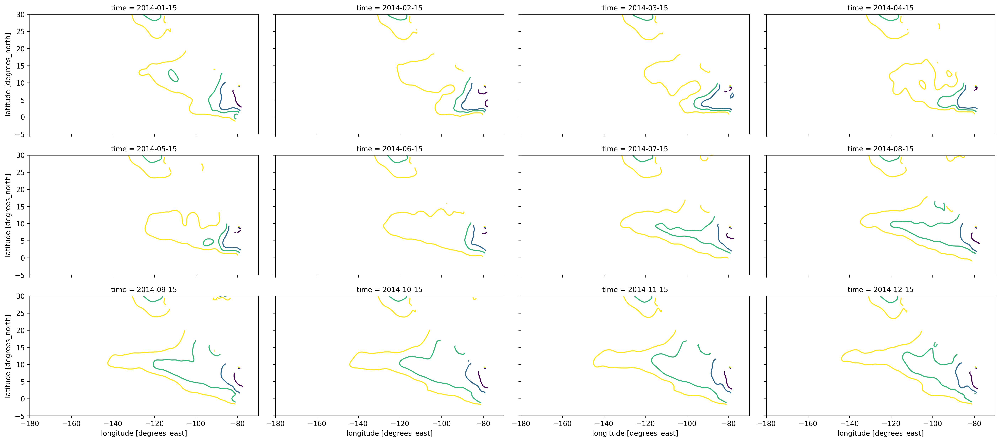

In [72]:
mimocml.SALINITY_MIXED_LAYER.plot.contour(
    levels=[32, 33, 33.5, 34], col="time", col_wrap=4, aspect=1.6
)

#### SSS merged

In [73]:
sss_clim = sss.groupby("time.month").mean().cf.sel(region).load().sss

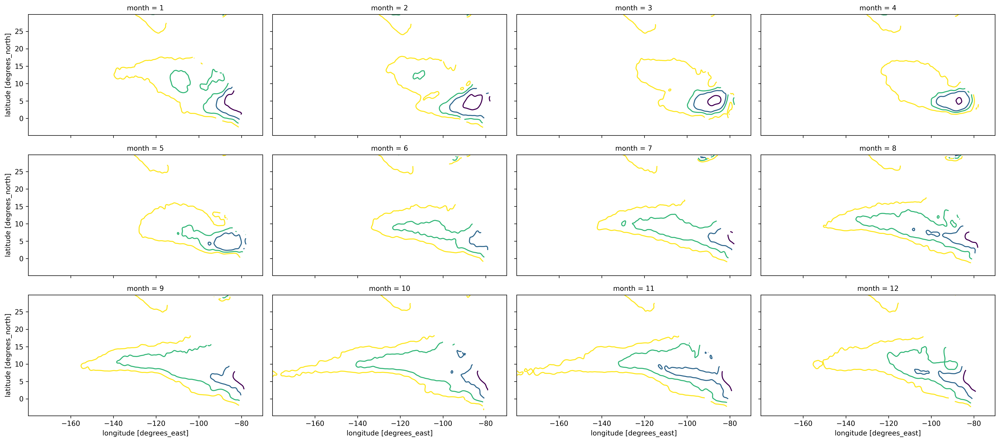

In [74]:
sss_clim.plot.contour(levels=[32, 33, 33.5, 34], col="month", col_wrap=4, aspect=1.6)

## MIMOC MLS vs SSS

This figure tries to figure out how well the climatological SSS contours line up with climatological ML salinity contours. 
- In red is the S=34 contour from the merged SSS product (2011-2021, 4 day). 
- In black dashed are [34, 34.1, 34.2] contours for MIMOC mixed layer salinity.

To within 0.2 psu; the S=34 contour at the surface is a reasonable approximation of S at the mixed layer base (climatologically)

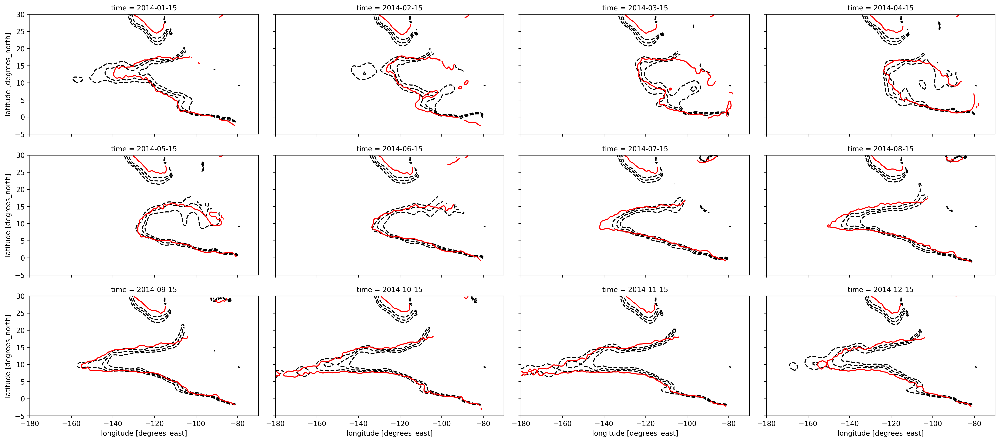

In [75]:
fg = mimocml.SALINITY_MIXED_LAYER.plot.contour(
    levels=[34, 34.1, 34.2],
    linestyles="--",
    colors="k",
    col="time",
    col_wrap=4,
    aspect=1.6,
)

for idx, ax in enumerate(fg.axes.flat):
    sss_clim.isel(month=idx).plot.contour(
        levels=[34], colors="r", ax=ax, add_labels=False
    )

## SSS contours

Visualizes each 4-day mean contour in a month with the monthly mean SSS contour.

In [10]:
sss_avg = (
    sss.sss.cf.sel(region)
    # 1°x1° average for smoothing
    .cf.coarsen(latitude=4, longitude=4)
    .mean()
    .load()
)
sss_monthly = sss_avg.groupby("time.month")

1. There seems to be a lot of zonal extension except during MAM
2. Long-lived eddies don't seem to exit the mean S=34 contour (red:tehuantepec, blue: papagayo, green: oce; Hasson et al 2019).

In [50]:
enso_labels = pump.make_enso_mask().reindex(time=sss_avg.time, method="nearest")
enso_monthly_mean_sss = dask_groupby.xarray.xarray_reduce(
    sss_avg, enso_labels, sss_avg.time.dt.month, func="mean", fill_value=np.nan
)

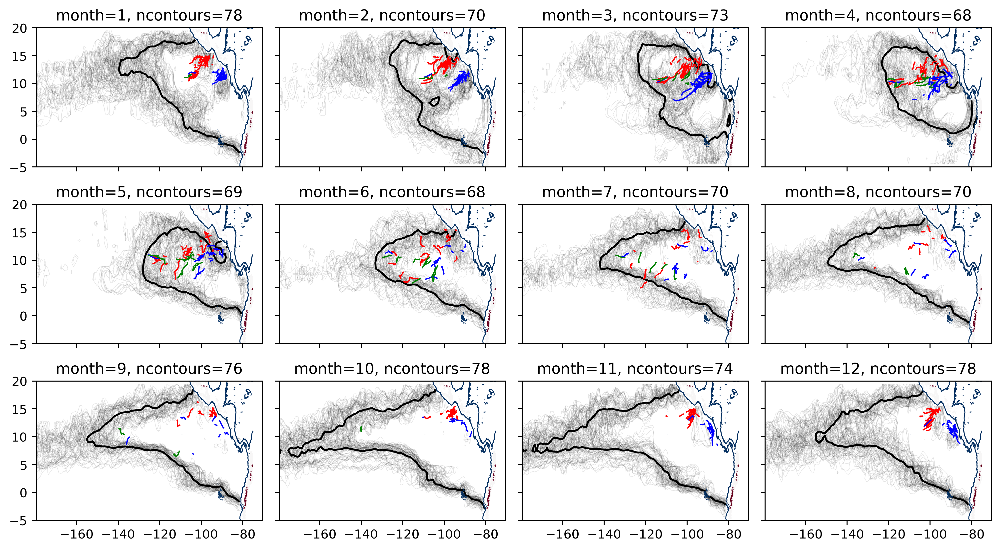

In [77]:
def plot_eddy_tracks_in_month(bytrack, month, ax=None):
    if ax is not None:
        plt.sca(ax)

    for kind, crit in etpac.eddy_kinds.items():
        color = crit["color"]
        subset = bytrack.query({"track": f"kind == {kind!r}"})

        # etpac.plot_tracks(subset, kind=kind, color=color, lw=0.1)
        etpac.plot_tracks(
            subset.where(subset.time.dt.month == month, drop=True),
            kind=kind,
            color=color,
            lw=1,
            initial=False,
        )


f, ax = plt.subplots(3, 4, sharex=True, sharey=True, constrained_layout=True)
for ax, (month, group) in zip(ax.flat, sss_monthly):
    group = group.cf.sel(latitude=slice(20))
    for t in range(group.sizes["time"]):
        group.isel(time=t).plot.contour(
            ax=ax,
            levels=[34],
            linewidths=0.4,
            colors="black",
            alpha=0.1,
            add_labels=False,
        )
    group.mean("time").plot.contour(
        ax=ax, levels=[34], linewidths=1.5, colors="k", add_labels=False
    )
    plot_eddy_tracks_in_month(bytrack, month=month, ax=ax)
    topo.sel(x=slice(-110, -70), y=slice(-5, 20)).plot.contour(
        levels=[0, 2000, 4000], linewidths=0.75, ax=ax, add_labels=False
    )
    ax.set_title(f"month={month}, ncontours={group.sizes['time']}")


f.set_size_inches((11, 6))

## ENSO phase-averaged SSS=34

Mean SSS=34 for ENSO phases. Note there are no observations for La-Nina Apr-Jul; and the mean mostly reflects Neutral state

In [82]:
enso_labels.groupby("time.month").map(lambda g: g.groupby(g).count())

<xarray.DataArray 'enso_phase' (month: 12, enso_phase: 3)>
array([[ 8., 15., 55.],
       [ 7., 11., 52.],
       [16.,  4., 53.],
       [27., nan, 41.],
       [31., nan, 38.],
       [30., nan, 38.],
       [27., nan, 43.],
       [19.,  5., 46.],
       [10., 16., 50.],
       [ 8., 15., 55.],
       [ 7., 15., 52.],
       [ 8., 16., 54.]])
Coordinates:
  * enso_phase  (enso_phase) object 'El-Nino' 'La-Nina' 'Neutral'
  * month       (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
Attributes:
    description:  ENSO phase; El-Nino = NINO34 SSTA > 0.4 for at least 6 mont...

Monthly mean S=34 partitioned by ENSO phase: {"Neutral": "sienna", "El-Nino": "orangered", "La-Nina": "navy"}. Full-time mean in thick black

/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.8/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.8/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/glade/u/home/dcherian/python/xarray/xarray/plot/plot.py:995: UserWarning: No contour levels were found within the data range.
  primitive = ax.contour(x, y, z, **kwargs)
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.8/site-packages/matplotlib/contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.8/site-packages/matplotlib/contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/glade/u/home/dcherian/python/xarray/xarray/plot/plot.py:995: UserWarning: No con

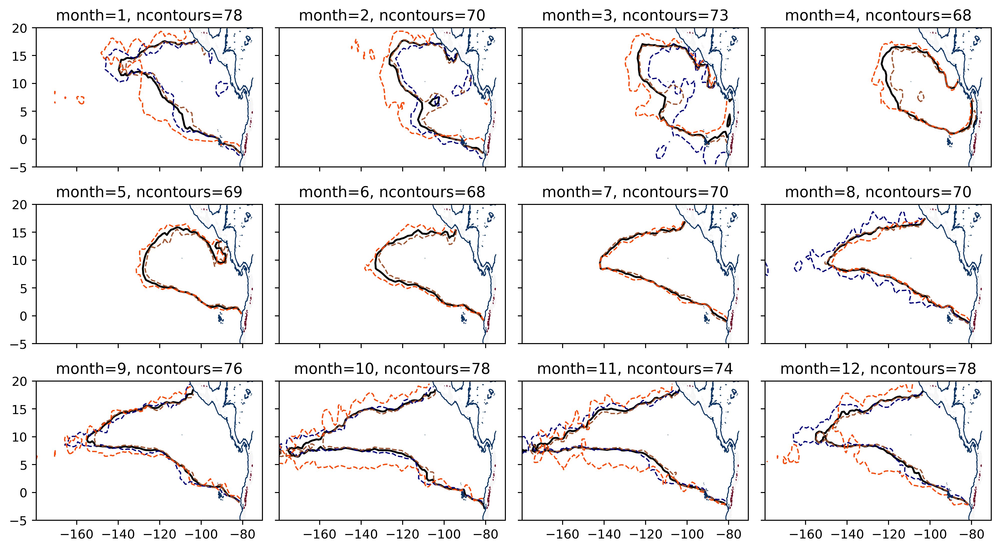

In [81]:
enso_colors = {"Neutral": "sienna", "El-Nino": "orangered", "La-Nina": "navy"}


f, ax = plt.subplots(3, 4, sharex=True, sharey=True, constrained_layout=True)
for ax, (month, group) in zip(ax.flat, sss_monthly):
    group = group.cf.sel(latitude=slice(20))
    group.mean("time").plot.contour(
        ax=ax, levels=[34], linewidths=1.5, colors="k", add_labels=False
    )

    for phase in enso_monthly_mean_sss.enso_phase.data:
        enso_monthly_mean_sss.cf.sel(
            latitude=slice(20), month=month, enso_phase=phase
        ).cf.plot.contour(
            ax=ax,
            levels=[34],
            linewidths=1,
            linestyles="--",
            colors=enso_colors[phase],
            add_labels=False,
        )
        
    topo.sel(x=slice(-110, -70), y=slice(-5, 20)).plot.contour(
        levels=[0, 2000, 4000], linewidths=0.75, ax=ax, add_labels=False
    )
    ax.set_title(f"month={month}, ncontours={group.sizes['time']}")


f.set_size_inches((11, 6))

## Long-lived eddy tracks

teh
pap
oce


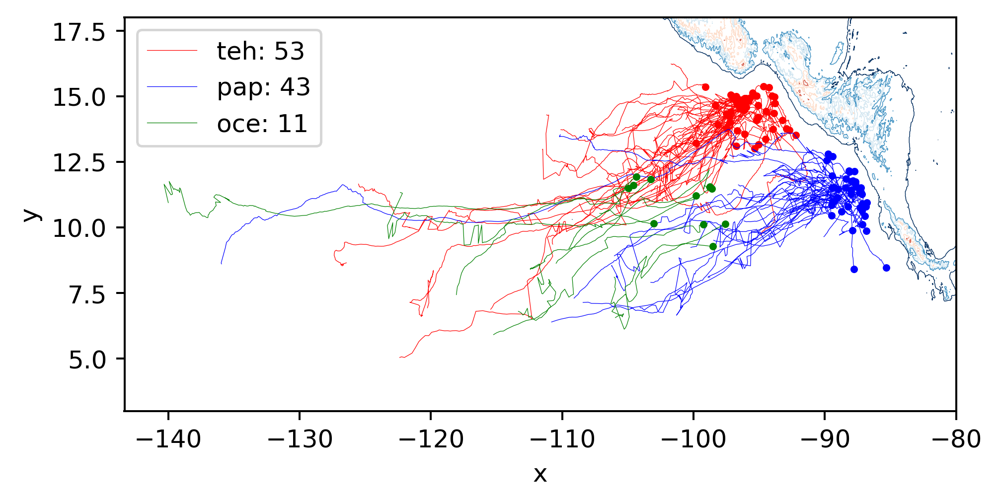

In [85]:
handles = []
for kind, crit in etpac.eddy_kinds.items():
    color = crit["color"]
    if kind == "all":
        continue
    masked = bytrack.query({"track": f"kind == {kind!r}"})
    hdl = etpac.plot_tracks(masked, kind=kind, color=color)
    print(kind)
    if hdl:
        handles.append(hdl[0])

topo_subset = topo.sel(x=slice(-110, -80), y=slice(5, 18))
#topo_subset["x"] = topo_subset.x + 360
topo_subset.plot.contour(
    levels=[0, 500, 1000, 2000, 3000, 4000], ax=plt.gca(), linewidths=0.3
)
plt.legend(handles=handles)
plt.xlim(None, -80)
plt.ylim(3, 18)
plt.gca().set_aspect(2)

## Process Chelton eddy tracks

Pulling out "long lived" eddy tracks following Hasson et al (2019)

In [50]:
tracks = xr.open_dataset(
    "/glade/u/home/dcherian/datasets/aviso-eddies/eddy_trajectory_2.0exp_19930101_20180118.nc"
)

In [51]:
tracks.longitude.load()

<xarray.DataArray 'longitude' (obs: 25871877)>
array([ 19.3175,  19.2417,  19.1798, ..., 256.399 , 256.402 , 256.405 ],
      dtype=float32)
Dimensions without coordinates: obs
Attributes:
    Longname:       longitude of measurement
    description:    observation longitude
    standard_name:  longitude
    units:          degrees_east
    min:            0.0
    max:            359.99936

In [78]:
subset = tracks.query(
    {"obs": "latitude > 3 and latitude < 20 and longitude > 180 and longitude < 360-65"}
)
subset.track.load()

<xarray.DataArray 'track' (obs: 763196)>
array([    72,     72,     72, ..., 352341, 352341, 352341], dtype=uint32)
Dimensions without coordinates: obs
Attributes:
    Longname:     track_number
    description:  eddy identification number
    units:        ordinal
    min:          0
    max:          352416

(array([4.060e+02, 3.860e+02, 1.147e+03, 3.051e+03, 2.075e+03, 1.417e+03,
        1.052e+03, 7.600e+02, 5.590e+02, 4.370e+02, 3.020e+02, 2.650e+02,
        2.110e+02, 1.620e+02, 1.400e+02, 1.060e+02, 7.400e+01, 7.100e+01,
        4.800e+01, 5.000e+01, 4.400e+01, 3.100e+01, 2.100e+01, 2.100e+01,
        1.700e+01, 1.400e+01, 1.400e+01, 1.000e+01, 7.000e+00, 2.000e+00,
        1.000e+00, 5.000e+00, 0.000e+00, 3.000e+00, 3.000e+00, 3.000e+00,
        2.000e+00, 1.000e+00, 0.000e+00, 3.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00]),
 array([  0,  10,  20,  30,  40,  50,  60,  70,  80,  90, 100, 110, 120,
        130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250,
        260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380,
        390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490]),
 <BarContainer object of 49 artists>)

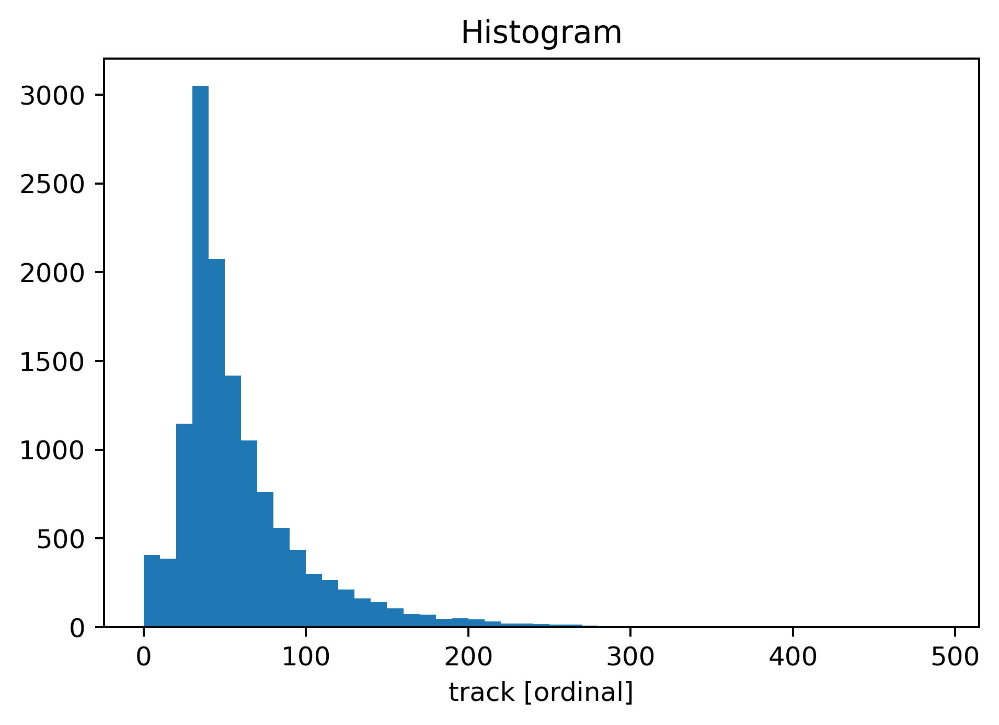

In [79]:
track_lengths = subset.track.groupby(subset.track).count()
track_lengths.plot.hist(bins=np.arange(0, 500, 10))

In [80]:
long_tracks = track_lengths.where(track_lengths > 30, drop=True).track.data
indexer = subset.track.isin(long_tracks).data
long_track_data = subset.sel(obs=indexer)[
    ["amplitude", "time", "track", "speed_radius", "latitude", "longitude"]
].load()

grouped = long_track_data.groupby("track")

In [81]:
datasets = [
    group.assign_coords(obs=np.arange(group.sizes["obs"]), track=group.track.data[0])
    for _, group in grouped
]

In [82]:
bytrack = xr.concat(datasets, dim="track").rename({"obs": "itime"}).drop_vars("itime")
bytrack.coords["lat0"] = bytrack.latitude.isel(itime=0)
bytrack.coords["lon0"] = bytrack.longitude.isel(itime=0)

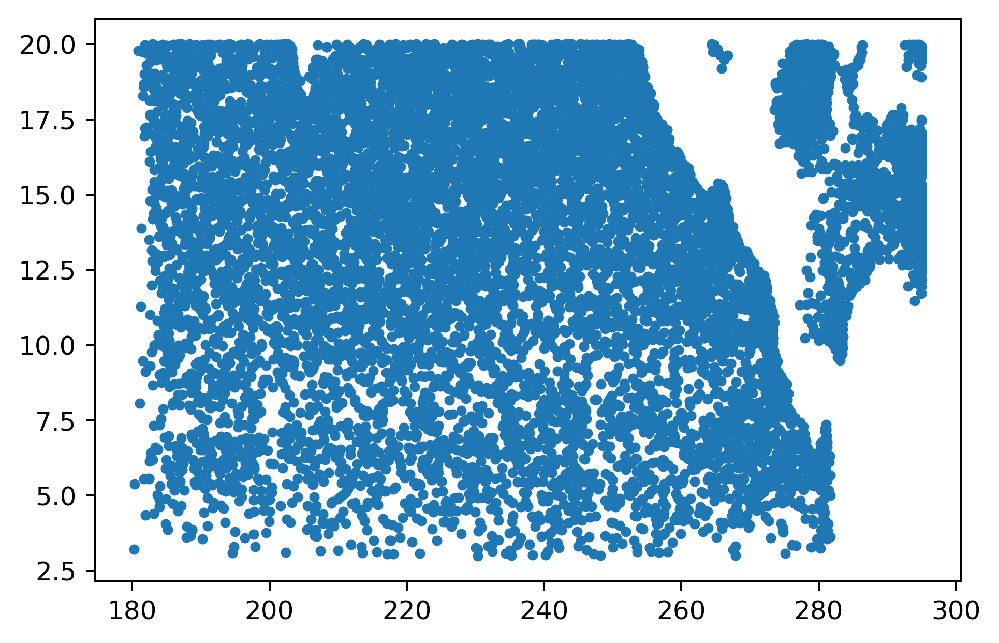

In [85]:
plt.plot(bytrack.lon0, bytrack.lat0, '.')

In [ ]:
bytrack.coords["kind"] = xr.full_like(bytrack.lon0, dtype="U3", fill_value="all")
for name, crit in etpac.eddy_kinds.items():
    mask = (
        (bytrack.lat0.data < crit["lat0"][1])
        & (bytrack.lat0.data > crit["lat0"][0])
        & (bytrack.lon0.data < crit["lon0"][1])
        & (bytrack.lon0.data > crit["lon0"][0])
        & (bytrack.amplitude > 20).any("itime")
        & (bytrack.speed_radius > 100).any("itime")
    )
    #print(name, np.sum(mask).data)
    bytrack.kind.data[mask] = name


In [234]:
import cftime

bytrack["time"] = bytrack.time.fillna(cftime.DatetimeJulian(1993, 1, 1, 0, 0, 0, 0))

In [235]:
bytrack.to_netcdf("long-eddy-tracks.nc")

<ipython-input-235-5c2f888bf50d>:1: SerializationWarning: saving variable speed_radius with floating point data as an integer dtype without any _FillValue to use for NaNs
  bytrack.to_netcdf("long-eddy-tracks.nc")


## ETPac MOM6 and obs videos

In [169]:
dirname = "/glade/p/nsc/ncgd0048/ETP_1_20/"
daily = f"{dirname}/COMPRESSED_OCEAN_DAILY/ocean_daily__201*.nc"
hourly = f"{dirname}/COMPRESSED_OCEAN_HOURLY/ocean_hourly__201*.nc"

In [170]:
cluster.scale(12)

In [171]:
dshour = xr.open_mfdataset(
    hourly, coords="minimal", compat="override", data_vars=["ssh"], parallel=True
)
dshour = dshour.coarsen(time=24).mean()
dshour["time"] = dshour.time.dt.floor("H")

ds = xr.open_mfdataset(
    daily, data_vars="minimal", coords="minimal", compat="override", parallel=True
)
geometry = xr.open_dataset(f"{dirname}/rundir/ETP.012/run/ocean_geometry.nc").rename(
    {"lath": "yh", "lonh": "xh", "latq": "yq", "lonq": "xq"}
)
ds = ds.cf.guess_coord_axis()
ds.coords.update(geometry)


def xgcm_grid_mom6(geometry):
    import xgcm

    grid = xgcm.Grid(
        geometry,
        coords={
            "X": {"center": "xh", "outer": "xq"},
            "Y": {"center": "yh", "outer": "yq"},
            "Z": {"inner": "z_l", "outer": "z_i"},
        },
        periodic=False,
        metrics={
            ("X",): ["dxT", "dxCu", "dxCv", "dxBu"],  # X distances
            ("Y",): ["dyT", "dyCu", "dyCv", "dyBu"],  # Y distances
            # ("Z",): ["drW", "drS", "drC"],  # Z distances
            ("X", "Y"): ["Ah", "Aq"],  # Areas
        },
        boundary={"X": "extend", "Y": "extend", "Z": "extend"},
    )
    grid.arakawa = "C"
    return grid

In [172]:
xr.align(ds, dshour, join="exact")
ds.update(dshour)
ds["xh"] = ds.xh - 360
ds["xq"] = ds.xq - 360
mean_ssh = ds["ssh"].mean("time").compute()
ds["ssha"] = ds.ssh - mean_ssh
ds.so.attrs["standard_name"] = "sea_surface_salinity"
ds.ssha.attrs["standard_name"] = "sea_surface_height_anomaly"
ds.D.attrs["standard_name"] = "water_depth"
ds

,Array,Chunk
Bytes,1.66 TB,504.00 MB
Shape,"(3287, 140, 900, 1000)","(1, 140, 900, 1000)"
Count,9861 Tasks,3287 Chunks
Type,float32,numpy.ndarray
,Array,Chunk
Bytes,1.66 TB,504.00 MB
Shape,"(3287, 140, 900, 1000)","(1, 140, 900, 1000)"
Count,9861 Tasks,3287 Chunks
Type,float32,numpy.ndarray
,Array,Chunk


In [272]:
subsurf = ds.cf.sel(longitude=slice(-75), latitude=slice(0, 18)).cf.sel(
    Z=100, method="nearest"
)
subsurf

<xarray.Dataset>
Dimensions:     (xh: 1000, yh: 360, time: 3287, nv: 2, xq: 1001, yq: 361)
Coordinates: (12/26)
  * xh          (xh) float64 -125.0 -124.9 -124.9 ... -75.12 -75.07 -75.02
  * yh          (yh) float64 0.025 0.075 0.125 0.175 ... 17.83 17.88 17.92 17.98
    zl          float64 98.75
  * time        (time) datetime64[ns] 2009-12-30T12:00:00 ... 2018-12-29T12:0...
  * nv          (nv) float64 1.0 2.0
  * xq          (xq) float64 -125.0 -124.9 -124.9 -124.8 ... -75.1 -75.05 -75.0
    ...          ...
    dyBu        (yq, xq) float64 ...
    Ah          (yh, xh) float64 ...
    Aq          (yq, xq) float64 ...
    dxCvo       (yq, xh) float64 ...
    dyCuo       (yh, xq) float64 ...
    wet         (yh, xh) float64 ...
Data variables: (12/22)
    thetao      (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    so          (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    uo          (time, yh, xq) float32 dask.array<chunksize=(1, 360, 1001), meta=np.ndarray>
    vo          (time, yq, xh) float32 dask.array<chunksize=(1, 361, 1000), meta=np.ndarray>
    average_T1  (time) datetime64[ns] dask.array<chunksize=(1,), meta=np.ndarray>
    average_T2  (time) datetime64[ns] dask.array<chunksize=(1,), meta=np.ndarray>
    ...          ...
    hflso       (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    hfsso       (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    rsntds      (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    hfds        (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    friver      (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    ssha        (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
Attributes:
    filename:   ocean_daily__2010_001.nc
    title:      MOM6 diagnostic fields table for CESM case: ETP.003
    grid_type:  regular
    grid_tile:  N/A

In [210]:
subset = ds.cf.sel(longitude=slice(-75), latitude=slice(0, 18)).cf.isel(Z=0)
subset

<xarray.Dataset>
Dimensions:     (xh: 1000, yh: 360, time: 3287, nv: 2, xq: 1001, yq: 361)
Coordinates: (12/26)
  * xh          (xh) float64 -125.0 -124.9 -124.9 ... -75.12 -75.07 -75.02
  * yh          (yh) float64 0.025 0.075 0.125 0.175 ... 17.83 17.88 17.92 17.98
    zl          float64 1.25
  * time        (time) datetime64[ns] 2009-12-30T12:00:00 ... 2018-12-29T12:0...
  * nv          (nv) float64 1.0 2.0
  * xq          (xq) float64 -125.0 -124.9 -124.9 -124.8 ... -75.1 -75.05 -75.0
    ...          ...
    dyBu        (yq, xq) float64 ...
    Ah          (yh, xh) float64 ...
    Aq          (yq, xq) float64 ...
    dxCvo       (yq, xh) float64 ...
    dyCuo       (yh, xq) float64 ...
    wet         (yh, xh) float64 ...
Data variables: (12/22)
    thetao      (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    so          (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    uo          (time, yh, xq) float32 dask.array<chunksize=(1, 360, 1001), meta=np.ndarray>
    vo          (time, yq, xh) float32 dask.array<chunksize=(1, 361, 1000), meta=np.ndarray>
    average_T1  (time) datetime64[ns] dask.array<chunksize=(1,), meta=np.ndarray>
    average_T2  (time) datetime64[ns] dask.array<chunksize=(1,), meta=np.ndarray>
    ...          ...
    hflso       (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    hfsso       (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    rsntds      (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    hfds        (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    friver      (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
    ssha        (time, yh, xh) float32 dask.array<chunksize=(1, 360, 1000), meta=np.ndarray>
Attributes:
    filename:   ocean_daily__2010_001.nc
    title:      MOM6 diagnostic fields table for CESM case: ETP.003
    grid_type:  regular
    grid_tile:  N/A

In [211]:
clean = subset.reset_coords("D")[["so", "ssha", "D"]].reset_coords(drop=True)

grid = xgcm_grid_mom6(subset)
clean["tauy"] = grid.interp(subset.tauy, axis="Y")
clean["taux"] = grid.interp(subset.taux, axis="X")

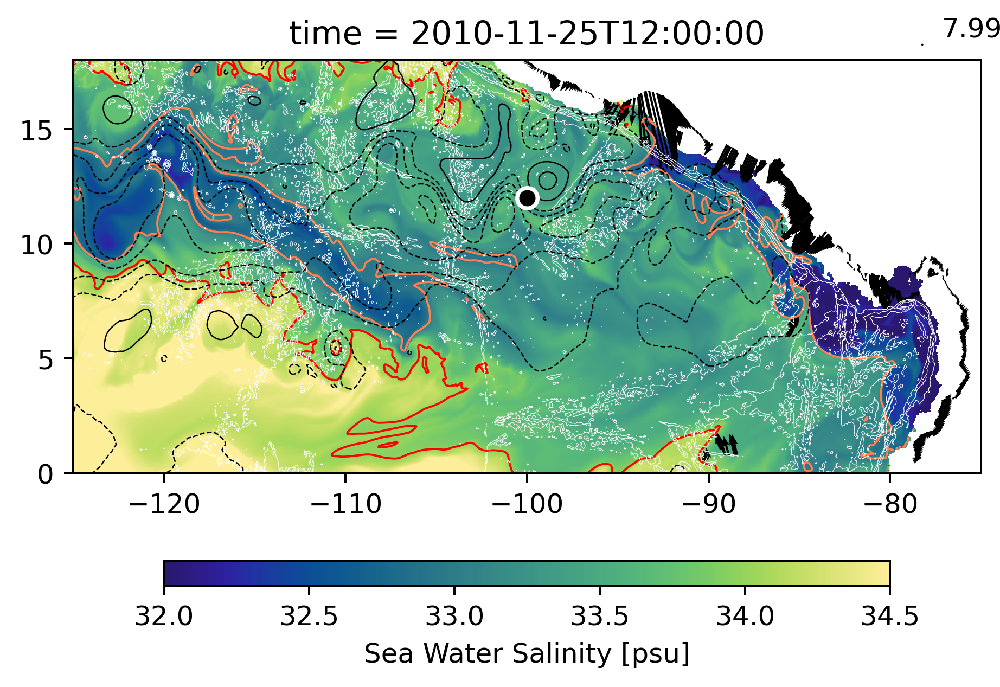

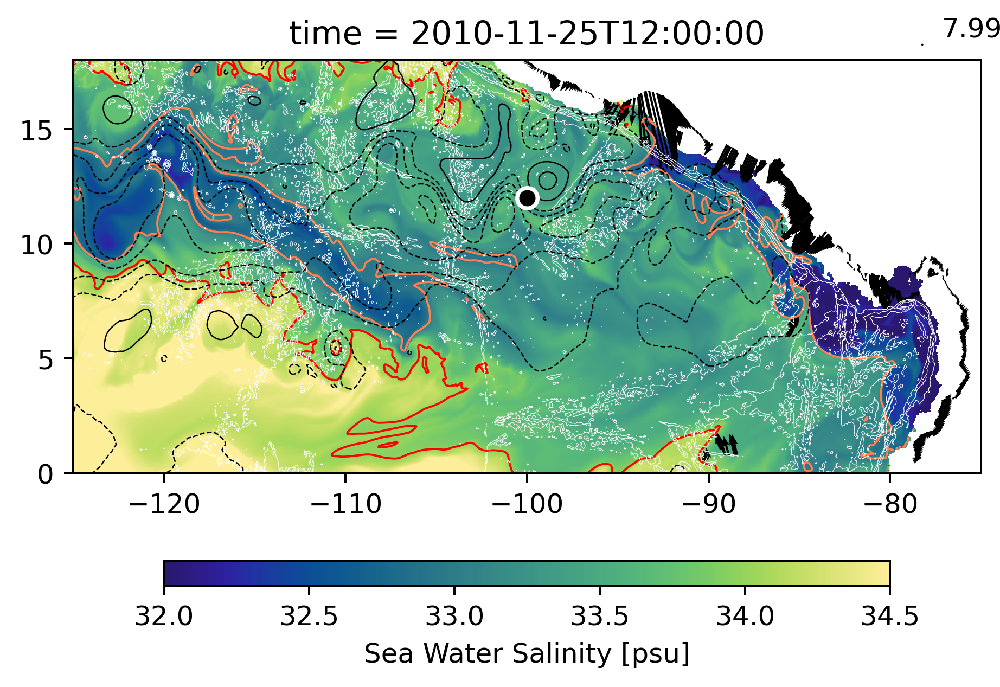

In [212]:
render(clean.isel(time=330))

In [67]:
def wrapper(subset, framedim=None):

    mpl.use("agg")
    render(subset, framedim)

    fig.savefig(
        f"../movies/sss_obs/{subset['time'].data}.png", dpi=300, bbox_inches="tight"
    )
    plt.close(fig)

    return subset["time"].expand_dims("time")


clean.map_blocks(
    wrapper,
    kwargs={"framedim": "time"},
    template=xr.ones_like(ds["time"]).chunk({"time": 1}),
).compute(scheduler=client)

<xarray.DataArray 'time' (time: 6940)>
array(['1999-12-30T12:00:00.000000000', '1999-12-31T12:00:00.000000000',
       '2000-01-01T12:00:00.000000000', ...,
       '2018-12-27T12:00:00.000000000', '2018-12-28T12:00:00.000000000',
       '2018-12-29T12:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 1999-12-30T12:00:00 ... 2018-12-29T12:00:00

### Obs plots

In [165]:
sss = xr.open_dataset(
    "/glade/work/dcherian/datasets/oisss_merged.zarr",
    engine="zarr",
    consolidated=True,
    chunks="auto",
)


topo = xr.open_dataset("/glade/u/home/dcherian/datasets/ETOPO2v2g_f4.nc4").sel(
    y=slice(0, 18), x=slice(-125, -75)
)
topo["z"].attrs["standard_name"] = "water_depth"
topo = (topo * -1).where(topo < 0)
topo["x"].attrs["units"] = "degrees_east"
topo["y"].attrs["units"] = "degrees_north"

ssh = xr.open_mfdataset(
    "/glade/u/home/dcherian/datasets/ssh/ssh_grids*.nc",
    parallel=True,
    data_vars="minimal",
    coords="minimal",
    compat="override",
    decode_coords="all",
)
ssh["Longitude"] = ssh.Longitude - 360
ssh["Longitude"].attrs["bounds"] = "Lon_bounds"
ssh["Latitude"].attrs["bounds"] = "Lat_bounds"
ssh.SLA.attrs["coordinates"] = "Time Latitude Longitude"
ssh = ssh.sel(Time=slice(sss.time[0].data, sss.time[-1].data))

/glade/u/home/dcherian/python/xarray/xarray/coding/times.py:119: SerializationWarning: Ambiguous reference date string: 1-1-1 00:00:0.0. The first value is assumed to be the year hence will be padded with zeros to remove the ambiguity (the padded reference date string is: 0001-1-1 00:00:0.0). To remove this message, remove the ambiguity by padding your reference date strings with zeros.
  warnings.warn(warning_msg, SerializationWarning)


In [181]:
ssh

<xarray.Dataset>
Dimensions:      (Longitude: 2160, nv: 2, Latitude: 960, Time: 541)
Coordinates:
    Lon_bounds   (Longitude, nv) float32 dask.array<chunksize=(2160, 2), meta=np.ndarray>
  * Longitude    (Longitude) float32 -359.9 -359.8 -359.6 ... -0.25 -0.08334
    Lat_bounds   (Latitude, nv) float32 dask.array<chunksize=(960, 2), meta=np.ndarray>
  * Latitude     (Latitude) float32 -79.92 -79.75 -79.58 ... 79.58 79.75 79.92
  * Time         (Time) datetime64[ns] 2011-08-29T12:00:00 ... 2019-01-24T12:...
    Time_bounds  (Time, nv) datetime64[ns] dask.array<chunksize=(1, 2), meta=np.ndarray>
Dimensions without coordinates: nv
Data variables:
    SLA          (Time, Longitude, Latitude) float32 dask.array<chunksize=(1, 2160, 960), meta=np.ndarray>
    SLA_ERR      (Time, Longitude, Latitude) float32 dask.array<chunksize=(1, 2160, 960), meta=np.ndarray>
Attributes: (12/15)
    Conventions:                     CF-1.6
    ncei_template_version:           NCEI_NetCDF_Grid_Template_v2.0
    Institution:                     Jet Propulsion Laboratory
    geospatial_lat_min:              -79.916664
    geospatial_lat_max:              79.916664
    geospatial_lon_min:              0.083333336
    ...                              ...
    date_created:                    2019-02-11T20:19:58.910660
    version_number:                  1812
    summary:                         Sea level anomaly grids from altimeter d...
    title:                           Sea Level Anormaly Estimate based on Alt...
    DODS_EXTRA.Unlimited_Dimension:  Time
    history:                         2021-07-02 17:17:58 GMT Hyrax-1.16.0 htt...

In [232]:
with dask.config.set(**{"array.slicing.split_large_chunks": True}):
    obs = xr.merge(
        [
            sss.sss.reindex(time=ssh.Time.data, method="nearest")
            .rename({"time": "Time"})
            .chunk({"Time": 1}),
            ssh.SLA,
            topo.z,
        ]
    )
obs.sss.attrs["standard_name"] = "sea_surface_salinity"
obs.SLA.attrs["standard_name"] = "sea_surface_height_anomaly"

In [233]:
subset_obs = obs.cf.sel(longitude=slice(-125, -75), latitude=slice(0, 18))

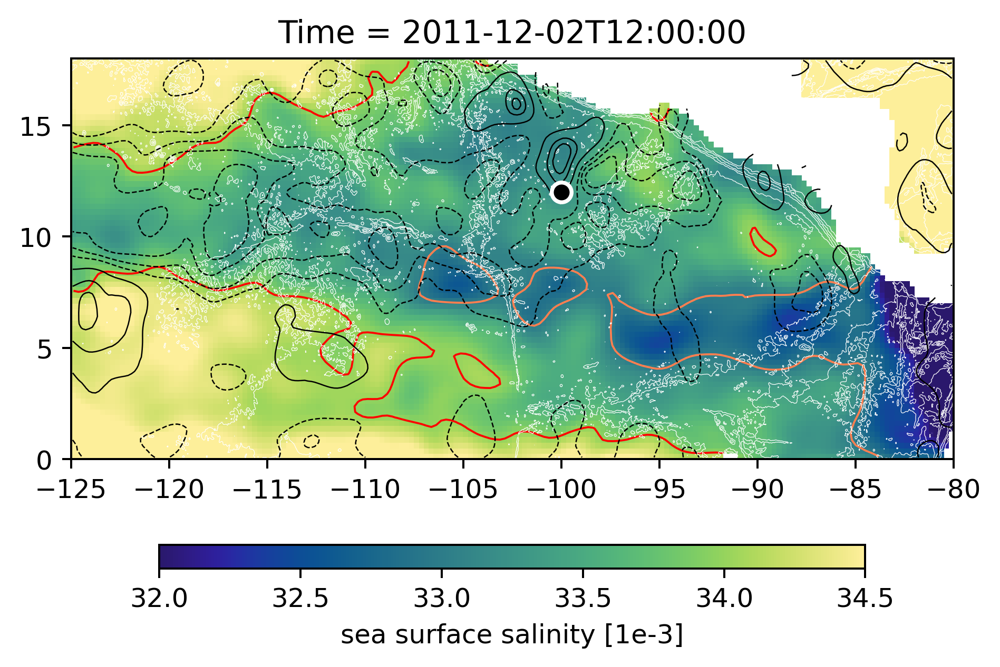

In [190]:
render(subset_obs.isel(Time=19));

In [255]:
def render(subset, fig=None, ax=None, framedim=None, add_colorbar=True):
    import cf_xarray
    import matplotlib as mpl
    import matplotlib.pyplot as plt

    if framedim is not None and subset.sizes[framedim] > 1:
        subset = subset.isel({framedim: 0})

    subset = subset.squeeze()
    plt.rcParams["font.size"] = 10

    if ax is None and fig is None:
        fig = plt.figure()
        ax = fig.subplots(1, 1)
    elif ax is not None:
        fig = ax.get_figure()

    if isinstance(subset, xr.DataArray):
        subset = subset.to_dataset(dim="variable")

    if add_colorbar:
        cbar_kwargs = {
            "orientation": "horizontal",
            "aspect": 30,
            "shrink": 0.8,
            "extend": "neither",
        }
    else:
        cbar_kwargs = None

    subset.cf["sea_surface_salinity"].cf.plot(
        robust=True,
        cmap=cmo.cm.haline,
        vmin=32,
        vmax=34.5,
        ax=ax,
        add_colorbar=add_colorbar,
        cbar_kwargs=cbar_kwargs,
    )
    subset.cf["sea_surface_salinity"].cf.plot.contour(
        levels=[33, 34],
        colors=["coral", "red"],
        ax=ax,
        linewidths=0.75,
    )
    if "water_depth" in subset.cf:
        subset.cf["water_depth"].plot.contour(
            colors="w", linewidths=0.25, levels=[1000, 2000, 3000, 4000], ax=ax
        )
    subset.cf["sea_surface_height_anomaly"].cf.plot.contour(
        colors="k",
        levels=[-0.25, -0.2, -0.15, -0.1, 0, 0.1, 0.15, 0.2, 0.25],
        linewidths=0.5,
        ax=ax,
    )

    if "taux" in subset:
        coastal_mask = (
            np.isnan(subset.taux.shift(xh=-1))
            | np.isnan(subset.taux.shift(yh=-1)) & (subset.yh < 19)
            # | np.isnan(subset.taux.shift(xh=1))
            # | np.isnan(subset.taux.shift(yh=1))
        )

        (
            subset.where(coastal_mask)
            .shift(xh=15, yh=15)
            .plot.quiver(
                x="xh",
                y="yh",
                u="taux",
                v="tauy",
                scale=2,
                color="k",
                pivot="tail",
                ax=ax,
            )
        )
    ax.plot(-100, 12, marker="o", markersize=8, color="w")
    ax.plot(-100, 12, marker="o", markersize=5, color="k")
    ax.set_xlabel("")
    ax.set_ylabel("")

    return fig

In [289]:
def wrapper_model_and_obs(model, obs, framedim=None):
    mpl.use("agg")

    fig, axes = plt.subplots(2, 1, sharex=True, sharey=True, constrained_layout=True)
    fig.set_size_inches((6, 6))

    render(model, ax=axes[0], add_colorbar=False, framedim=framedim)
    render(obs, ax=axes[1], framedim=framedim)

    axes[1].set_title("")
    # plt.tight_layout()

    fig.savefig(
        f"../movies/sss_obs/{obs[framedim].squeeze().data}.png",
        dpi=200,
        bbox_inches="tight",
    )
    plt.close(fig)

    return obs[framedim]  # .expand_dims(framedim)

In [293]:
cluster.close()

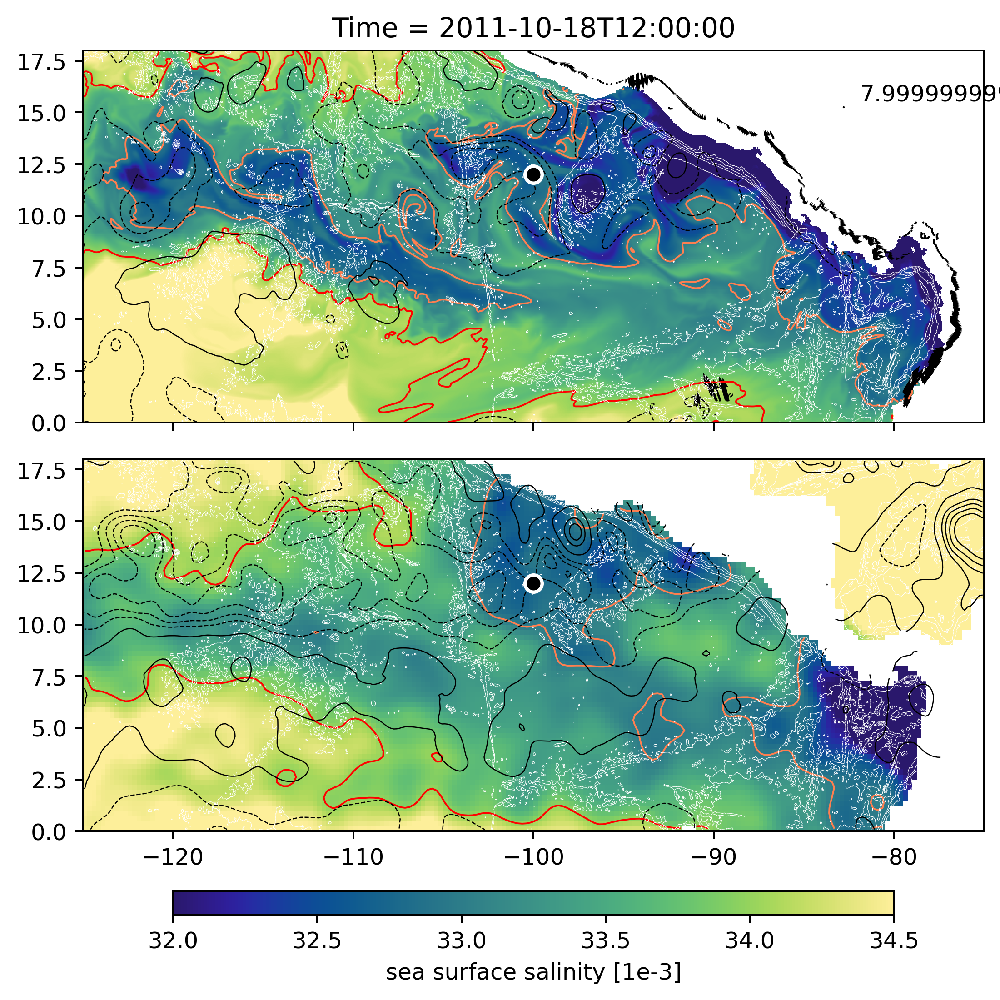

In [235]:
wrapper_model_and_obs(
    model=clean.sel(time=subset_obs.Time.data, method="nearest")
    .rename({"time": "Time"})
    .isel(Time=10),
    obs=subset_obs.isel(Time=10),
)

In [290]:
model = clean.rename({"time": "Time"}).sel(
    Time=slice(subset_obs.Time[0].data, subset_obs.Time[-1].data)
)

frames = xr.map_blocks(
    wrapper_model_and_obs,
    model,
    args=(
        subset_obs.reindex(Time=model.Time.data, method="nearest").chunk({"Time": 1}),
    ),
    kwargs={"framedim": "Time"},
    template=xr.ones_like(model["Time"]).chunk({"Time": 1}),
)

In [277]:
cluster.scale(24)

In [291]:
frames.compute()

<xarray.DataArray 'Time' (Time: 2680)>
array(['2011-08-29T12:00:00.000000000', '2011-08-30T12:00:00.000000000',
       '2011-08-31T12:00:00.000000000', ...,
       '2018-12-27T12:00:00.000000000', '2018-12-28T12:00:00.000000000',
       '2018-12-29T12:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
  * Time     (Time) datetime64[ns] 2011-08-29T12:00:00 ... 2018-12-29T12:00:00

### subsurface

In [273]:
cleansub = subsurf.reset_coords("D")[["so", "ssha", "D"]].reset_coords(drop=True)

grid = xgcm_grid_mom6(subset)
cleansub["tauy"] = grid.interp(subset.tauy, axis="Y")
cleansub["taux"] = grid.interp(subset.taux, axis="X")

## Old stuff

### xmovie

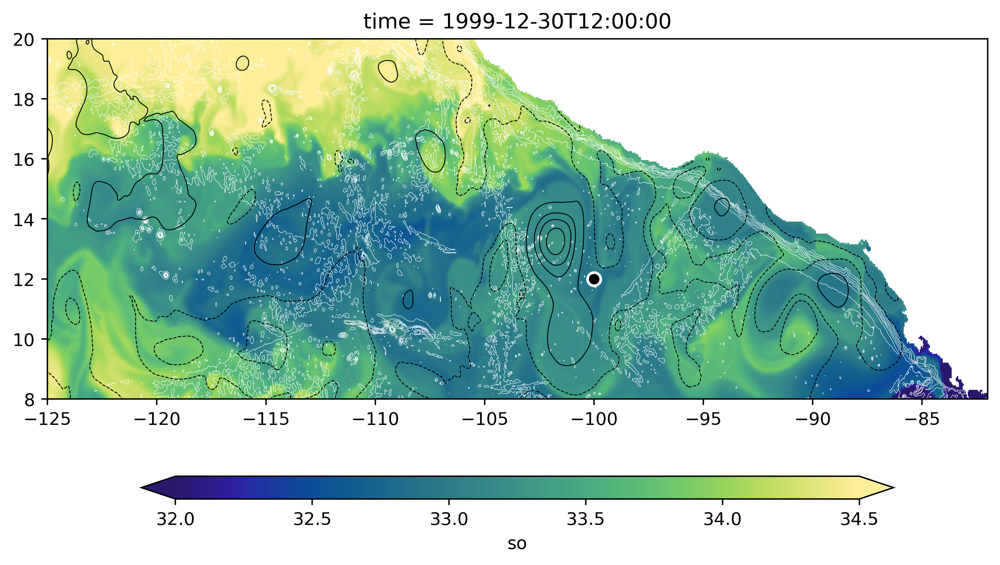

In [170]:
import xmovie

movie = xmovie.Movie(clean.to_array(dim="variable"), vmin=10, vmax=20, plotfunc=render)
movie.preview(10)

### interactive slider

In [ ]:
slider = pnw.IntSlider(name="time", start=0, end=subset.sizes["time"])
subset.interactive.isel(time=slider).pipe(render)

### bokeh

In [53]:
subset["so"] = subset.so.persist()
subset["ssha"] = subset.ssha.persist()

In [70]:
##kwargs = dict(x="xh", y="yh", groupby="time")
salt = subset.so.hvplot.image(**kwargs, cmap="magma", clim=(32, 34.5))
depth = subset.D.reset_coords(drop=True).hvplot.contour(x="xh", y="yh", cmap=["white"])
ssha = subset.ssha.reset_coords(drop=True).hvplot.contour(
    **kwargs, levels=(-0.2, -0.15, -0.1, 0.1, 0.15, 0.2), cmap=["black"]
)

(salt * depth * ssha)

:DynamicMap   [time]
   :Overlay
      .Image.I     :Image   [xh,yh]   (so)
      .Contours.I  :Contours   [xh,yh]   (D)
      .Contours.II :Contours   [xh,yh]   (ssha)

## Download OISSS data

In [23]:
import xarray as xr

ds = xr.open_dataset(
    "http://apdrc.soest.hawaii.edu:80/dods/public_data/satellite_product/OISSS/Aquarius_SMAP_OISSS_L4_multimission_global_7d_v1.0",
    engine="netcdf4",
    chunks={"time": 30},
    decode_times=False,
)
ds

<xarray.Dataset>
Dimensions:          (time: 872, lat: 720, lon: 1440)
Coordinates:
  * time             (time) float64 7.344e+05 7.344e+05 ... 7.379e+05 7.379e+05
  * lat              (lat) float64 -89.88 -89.62 -89.38 ... 89.38 89.62 89.88
  * lon              (lon) float64 -179.9 -179.6 -179.4 ... 179.4 179.6 179.9
Data variables:
    sss              (time, lat, lon) float32 dask.array<chunksize=(30, 720, 1440), meta=np.ndarray>
    sss_uncertainty  (time, lat, lon) float32 dask.array<chunksize=(30, 720, 1440), meta=np.ndarray>
Attributes:
    title:          Multi-Mission OISSS 7-Day Global Dataset V1.0
    Conventions:    COARDS\nGrADS
    dataType:       Grid
    documentation:  http://apdrc.soest.hawaii.edu/datadoc/oisss_multi.php
    history:        Thu Jul 01 10:54:37 HST 2021 : imported by GrADS Data Ser...

In [27]:
cluster.scale(8)

In [25]:
ds = ds.persist()

In [29]:
ds.to_zarr("~/datasets/oisss_merged.zarr", consolidated=True)

In [35]:
import cf_xarray